Segmentasi Sel Darah

Import Library:

cv2: Untuk membaca dan memproses gambar menggunakan OpenCV.

numpy:  Untuk manipulasi array dan operasi numerik.

matplotlib.pyplot:  Untuk menampilkan hasil pemrosesan citra.

os: Untuk mengakses file dan folder dalam sistem

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

Fungsi ini digunakan untuk memuat semua gambar dari folder tertentu, mengonversinya ke dalam format skala abu-abu, dan menyimpannya dalam sebuah list bersama dengan nama file aslinya.m

In [14]:
def load_images_from_folder(folder_path):
    images = []
    for filename in os.listdir(folder_path):
        if filename.endswith(('.png', '.jpg', '.jpeg')):
            img_path = os.path.join(folder_path, filename)
            image = cv2.imread(img_path)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            images.append((image, gray, filename))
    return images

Fungsi ini digunakan untuk menghaluskan gambar skala abu-abu dengan menerapkan Gaussian Blur, yang membantu mengurangi noise dan detail kecil sebelum pemrosesan lebih lanjut.

In [15]:
def apply_blur(gray_image):
    return cv2.GaussianBlur(gray_image, (5,5), 0)

Fungsi ini digunakan untuk mendeteksi tepi pada gambar yang sudah dihaluskan dengan Gaussian Blur. Metode yang digunakan adalah Canny Edge Detection, yang bekerja dengan dua ambang batas (`threshold1` dan `threshold2`) untuk menentukan tepi yang signifikan dalam gambar.

In [16]:
def apply_canny(blurred_image, threshold1=100, threshold2=200):
    return cv2.Canny(blurred_image, threshold1, threshold2)

Fungsi ini digunakan untuk membersihkan hasil deteksi tepi dengan menerapkan operasi morfologi **closing**. Operasi ini menggunakan kernel berukuran 3x3 untuk mengisi celah kecil pada tepi yang terdeteksi, sehingga hasil segmentasi menjadi lebih halus dan terhubung dengan lebih baik.

In [17]:
def clean_edges(edges):
    kernel = np.ones((3,3), np.uint8)
    return cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

Fungsi ini bertujuan untuk melakukan segmentasi sel darah dari semua gambar dalam folder tertentu.  

1. **Memuat Gambar:** Fungsi pertama-tama memuat semua gambar dalam folder yang diberikan.  
2. **Pra-pemrosesan:** Setiap gambar dikonversi ke grayscale, lalu diterapkan Gaussian Blur untuk mengurangi noise.  
3. **Deteksi Tepi:** Menggunakan algoritma Canny untuk mendeteksi tepi objek dalam gambar.  
4. **Pembersihan Tepi:** Menerapkan operasi morfologi untuk menghubungkan tepi yang putus-putus agar segmentasi lebih baik.  
5. **Menampilkan Hasil:** Menampilkan gambar asli, hasil deteksi tepi, dan hasil segmentasi dalam satu figure menggunakan Matplotlib.  

In [18]:
def segment_blood_cells_from_folder(folder_path):
    images = load_images_from_folder(folder_path)
    for image, gray, filename in images:
        # Preprocessing
        blurred = apply_blur(gray)
        edges = apply_canny(blurred)
        cleaned_edges = clean_edges(edges)
        
        # Display Results
        fig, ax = plt.subplots(1, 3, figsize=(15,5))
        ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax[0].set_title(f"Original Image - {filename}")
        ax[0].axis("off")
        
        ax[1].imshow(edges, cmap='gray')
        ax[1].set_title("Canny Edge Detection")
        ax[1].axis("off")
        
        ax[2].imshow(cleaned_edges, cmap='gray')
        ax[2].set_title("Segmented Image (Canny + Morphology)")
        ax[2].axis("off")
        
        plt.show()

Kode ini menjalankan proses segmentasi sel darah pada semua gambar yang terdapat dalam folder `test\original`.  

- **Membaca Gambar:** Mengambil semua gambar dari folder yang diberikan.  
- **Pra-pemrosesan:** Mengubah gambar menjadi grayscale dan menerapkan Gaussian Blur untuk mengurangi noise.  
- **Deteksi Tepi:** Menggunakan metode Canny Edge Detection untuk mendeteksi tepi objek dalam gambar.  
- **Pembersihan Tepi:** Menggunakan operasi morfologi untuk menyempurnakan hasil deteksi tepi.  
- **Menampilkan Hasil:** Memvisualisasikan gambar asli, hasil deteksi tepi, dan hasil segmentasi yang sudah diperbaiki.  

Dengan eksekusi kode ini, semua gambar dalam folder `test\original` akan diproses dan ditampilkan hasil segmentasinya.

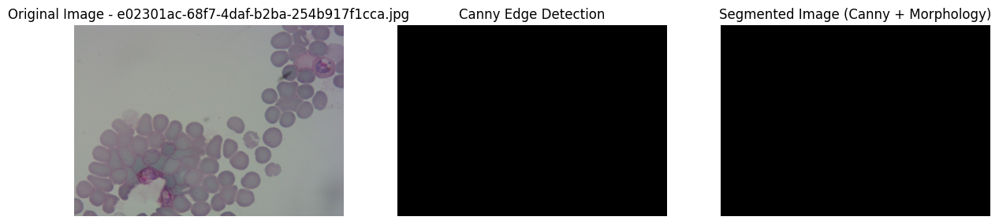

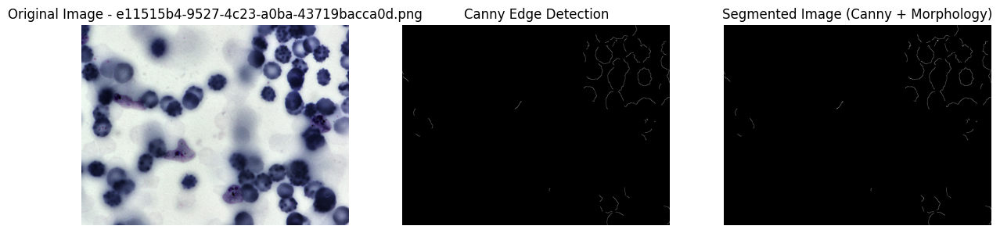

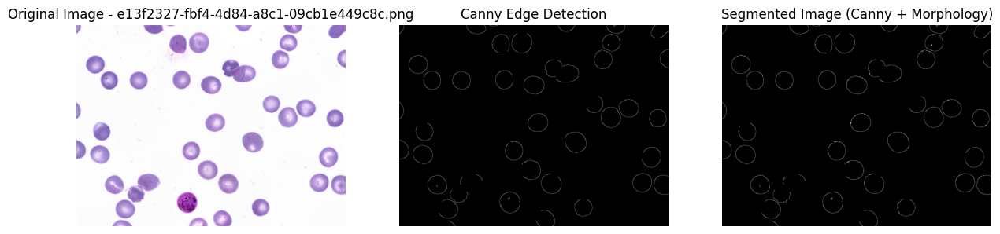

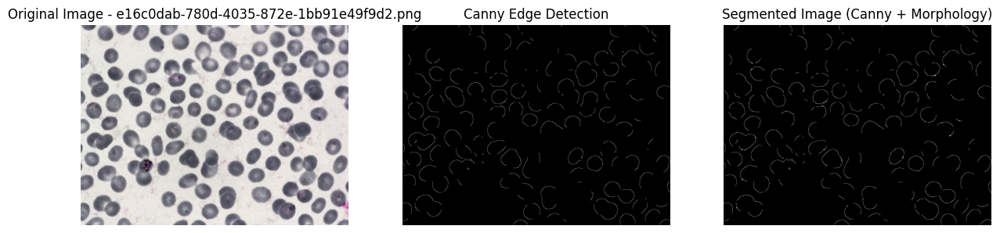

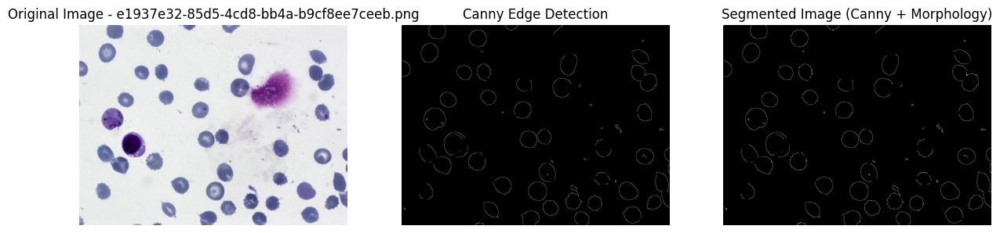

...

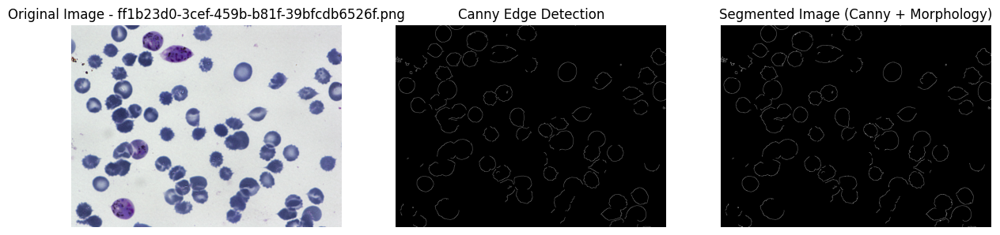

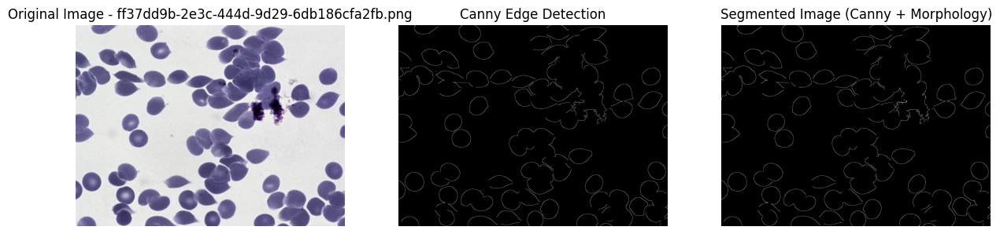

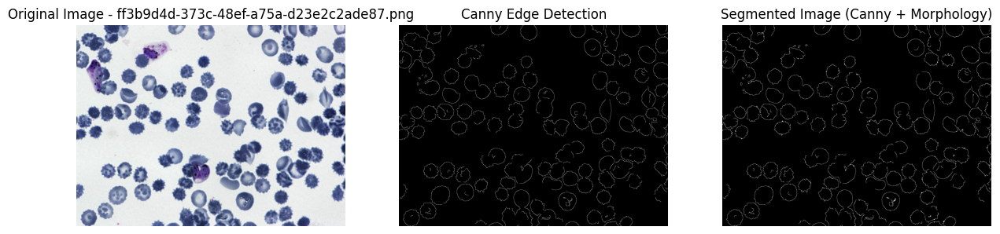

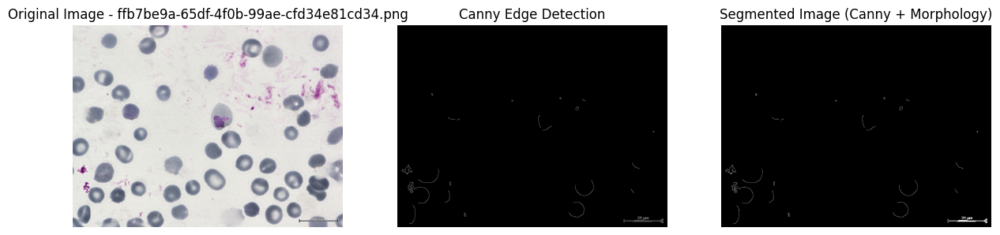

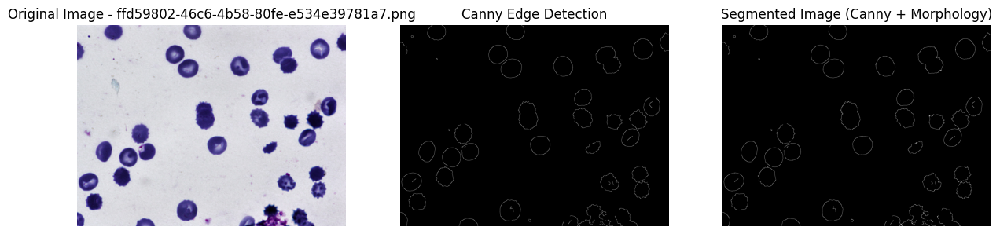

In [19]:
segment_blood_cells_from_folder(r"D:\kuliyah\Semester 4 (SE)\Pengenalan Pola\segmentasi sel darah\dataset\test\original")
